# TP Analyse bayésienne avec MRF
Pour cette partie nous allons réaliser la classification binaire d'une image en niveaux de gris **_Iobservee_** (image des observations, réalisation $y$ du champ $Y$) en utilisant un modèle markovien. 

Dans ce cas idéal, on nous donne la solution idéale $x$ (image binaire **_IoriginaleBW_**), réalisation du champ des classes $X$, qui nous servira pour évaluer la qualité de la solution $\hat{x}$ que nous aurons obtenue. (NB En pratique habituellement, on n'a pas accès à $x$). 

Dans cette partie nous allons utiliser la fonction **_affiche_** pour visualiser les images.





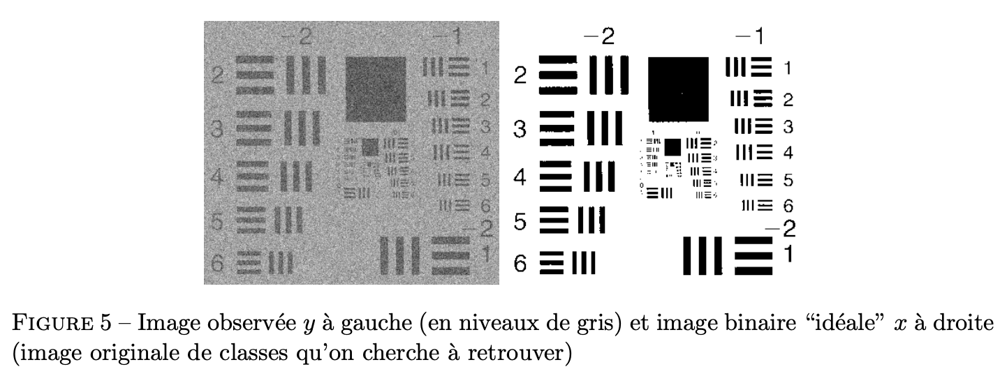

In [1]:
import math
import random
import numpy as np
import platform
import tempfile
import os
import matplotlib.pyplot as plt
import imageio
from scipy import ndimage as ndi
from skimage import io

from bokeh.plotting import figure, output_file, show
from bokeh.plotting import show as showbokeh
from bokeh.io import output_notebook
output_notebook()

In [2]:
def affiche_pour_colab(im,MINI=None, MAXI=None,titre=''): #special colab, ne pas regarder
  def normalise_image_pour_bokeh(X,MINI,MAXI): 
    if MAXI==None:
      MAXI = np.max(X)
    if MINI==None:
      MINI = np.min(X)
    imt=np.copy(X.copy())
    imt=(np.clip(imt,MINI,MAXI)/(MAXI-MINI))
    imt[imt<0]=0
    imt[imt>1]=1

    imt*=255
    
    sortie=np.empty((*imt.shape,4),dtype=np.uint8)
    for k in range(3):
      sortie[:,:,k]=imt
    sortie[:,:,3]=255
    return sortie
  img=normalise_image_pour_bokeh(np.flipud(im),MINI,MAXI)# np.flipud(np.fliplr(im)))
  p = figure(tooltips=[("x", "$x{int}"), ("y", "$y{int}"), ("value", "@image")],title=titre, y_range=[im.shape[0],0], x_range=[0, im.shape[1]],match_aspect=True)
  #p.x_range.range_padding = p.y_range.range_padding = 0

  # must give a vector of images
  p.image_rgba(image=[img], x=0,y=im.shape[0], dw=im.shape[1], dh=im.shape[0])
  showbokeh(p)

def affiche(im,MINI=0.0, MAXI=None,titre='',printname=False):
    affiche_pour_colab(im,MINI=MINI, MAXI=MAXI,titre=titre) # sous google colab beaucoup d''options disparaissent

La librairie scikit-image permet de lire des images à partir d'un URL. La fonction "affiche" permet d'accéder directement aux niveaux de gris et aux positions des pixels en utilisant la souris.

In [3]:
im_obs=io.imread("https://perso.telecom-paristech.fr/tupin/cours/IMA203/TPMARKOV/Iobservee.png")

affiche(im_obs)

In [4]:
im_ori=imageio.imread('https://perso.telecom-paristech.fr/tupin/cours/IMA203/TPMARKOV/IoriginaleBW.png')

affiche(im_ori)

L'objectif est d'estimer $x$ à partir de y en utilisant un a priori sur $P(X)$ sous forme d'un modèle Markovien. 
 On note $x_s$ la classe du pixel $s$ (que l'on cherche), et $y_s$ le niveau de gris observé. L'objectif est d'utiliser un modèle global sur le champ aléatoire $X$ pour classer l'image. Comme nous l'avons vu en cours cela revient à minimiser l'énergie suivante:

$$U(x|y)=\sum_s -ln(P(Y_s=y_s |X_s=x_s))+\sum_c U_c(x_s, s\in c)$$ 

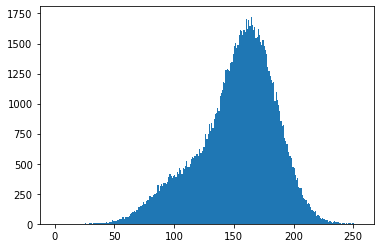

In [5]:
#etude des de la distribution globale de l'image
#affichage de l'histogramme de l'image 
plt.figure()
plt.hist(im_obs.ravel(),range=[0,np.max(im_obs)],bins=np.max(im_obs))
plt.show()

## 1. Analyse des distributions des niveaux de gris
Dans cette partie, on fait l'apprentissage des probabilités $P(Y_s=y_s |X_s)$, c'est à dire de $P(Y_s=y_s |X_s=0)$ et $P(Y_s=y_s |X_s=1)$. Cela revient à étudier l'histogramme des niveaux de gris de pixels qui sont dans la classe 0 et de pixels qui sont dans la classe 1.  


Pour réaliser cet apprentissage, il faut sélectionner des pixels appartenant à la classe 0 d'une part (zone sombre de l'image observée), et des pixels appartenant à la classe 1 d'autre part (zone claire de l'image observée). 

On pourra sélectionner des pixels manuellement, en utilisant la commande `v0=I[i1:i2,j1:j2]` sous Python qui met dans un vecteur toutes les valeurs des pixels de l'image $I$ compris entre les indices $i1$ et $i2$ (lignes), et $j1$ et $j2$ (colonnes).

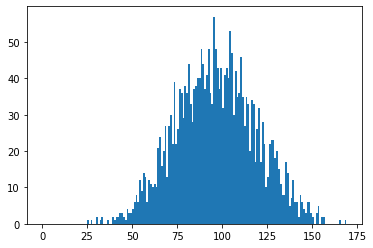

In [25]:
#selectionner une imagette dans une région sombre de l'image (classe 0)
#attention les ordonnées correspondent aux lignes et les abscisses aux colonnes
crop_classe0=im_obs[50:100,180:230]
#visualiser l'imagette
affiche(crop_classe0)
#tracer son histogramme
plt.figure()
plt.hist(crop_classe0.ravel(),range=[0,np.max(crop_classe0)],bins=np.max(crop_classe0))
plt.show()

In [26]:
#calculer sa moyenne et sa variance
#
#  Par défaut, np.mean, np.zzz prend les deux axes de l'image. 
#   Il faut forcer l'option si l'on veut faire la moyenne en ligne ou en colonne
# utiliser np.mean et np.var
m0= np.mean(crop_classe0)
var0= np.var(crop_classe0)

print(m0)
print(var0)

96.202
500.4323960000001


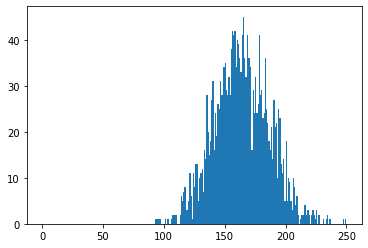

In [31]:
#sélectionner une imagette dans une région claire de l'image (classe 1)
crop_classe1=im_obs[270:300,130:200]
#visualiser l'imagette
affiche(crop_classe1)
#tracer son histogramme
plt.figure()
plt.hist(crop_classe1.ravel(),range=[0,np.max(crop_classe1)],bins=np.max(crop_classe1))
plt.show()

In [32]:
#calculer sa moyenne et sa variance 
m1= np.mean(crop_classe1)
var1= np.var(crop_classe1)

print(m1)
print(var1)

163.7342857142857
516.6589197278912


### Q1
Quelles sont les distributions suivies par les niveaux de gris dans ces deux classes ? Donnez les moyennes et variances des deux classes que vous avez estimées. 

### A1

Les deux classes suivent la loi gaussienne. 


*   La première classe sombre (**classe 0**) a la moyenne égale a 96.2 et la variance égale à 500.4 ; 
*   La second classe claire (**classe 1**) a la moyenne égale a 163.7 et la variance égale à 516.6. 


### Q2
Dans la suite, on supposera les variances égales pour pouvoir simplifier les expressions de l'énergie. 

Supposons qu'on n'utilise pas de modèle markovien sur $X$ et qu'on classe un pixel seulement en fonction de son niveau de gris en comparant $P(Y_s=y_s |X_s=0)$ et $P(Y_s=y_s |X_s=1)$. Montrez que cela revient à seuiller l'image et donnez la valeur du seuil optimal en fonction des paramètres trouvés précédemment (on dit qu'on fait une classification par maximum de vraisemblance ponctuel).

### A2
Si nous classons un pixel seulement en fonction de son niveau de gris, nous pouvons écrire que :

* $P(Y_s|0)= \mathcal{N}(96,500)$
* $P(Y_s|1)= \mathcal{N}(164,500)$

<br>

Nous pouvons écrire la loi gaussienne : $P(Y_s|X_s)=\frac{1}{\sqrt{2\pi}\sigma_{x_s}}\exp^{\frac{-(y_s-\mu_{x_s})^2}{2\sigma_{x_s}^2}}$

<br>

Donc pour classifier un pixel comme de **Classe 0**, nous devons avoir que : 

<br>

$$P(Y_s| 0)>P(Y_s|1)$$

<br>

$$\frac{1}{\sqrt{2\pi}\sigma_{0}}\exp^{\frac{-(y_s-\mu_{0})^2}{2\sigma_{0}^2}}>\frac{1}{\sqrt{2\pi}\sigma_{1}}\exp^{\frac{-(y_s-\mu_{1})^2}{2\sigma_{1}^2}}$$

<br>

Comme nous avons défini que les distributions ont la même variance :

$$(y_s-\mu_0)^2 < (y_s-\mu_1)^2$$

En fin, la seille est donnée par :
$$y_s < \frac{\mu_0+\mu_1}{2}$$


In [38]:
#definir le seuil pour faire une classification au sens du MV et afficher l'image
seuil= (m0+m1)/2.
im_bin=im_obs.copy()
nl,nc=im_bin.shape
for i in range(nl):
  for j in range(nc):
    if (im_bin[i][j]>seuil):
      im_bin[i][j]=1
    else:
      im_bin[i][j]=0
affiche(im_bin)

### Q3
A partir des résultats trouvés pour $P(Y_s=y_s |X_s)$, écrivez l'énergie d'attache aux données $$U_{attdo}=\sum_s -ln(P(Y_s=y_s |X_s=x_s))$$ 

### A3
Comme, nous avons déjà montrer, nous pouvons écrire la loi gaussienne : $P(Y_s|X_s)=\frac{1}{\sqrt{2\pi}\sigma_{x_s}}\exp^{\frac{-(y_s-\mu_{x_s})^2}{2\sigma_{x_s}^2}}$


Si nous prenons le -ln de la probabilité : $-lnP(Y_s|X_s)=\frac{(y_s-\mu_{x_s})^2}{2\sigma_{x_s}^2}+\ln\sqrt{2\pi}\sigma_{x_s}$

<br>

Comme les distributions ont la même variance, l'énergie d'attache aux données est données pour :
$$U_{attdo}=\sum_{s}\frac{(y_s-\mu_{x_s})^2}{2\sigma^2}+\ln\sqrt{2\pi}\sigma$$


## 2 Modèle d'Ising pour la régularisation et énergies
Pour améliorer les résultats du seuillage, il est nécessaire d'introduire une régularisation (modèle a priori global).

### Q4
Soit la fonction $\Delta(x_s,x_t)=0$ si $x_s=x_t$, et $\Delta(x_s,x_t)=1$ sinon. Ecrire le potentiel des cliques d'ordre deux pour ce modèle d'Ising en fonction de $\Delta(x_s,x_t)$ où $x_s$ et $x_t$ sont les classes des pixels $s$ et $t$ voisins en 4-connexité et du paramètre de régularisation $\beta$. Ce modèle vaudra 0 quand les deux pixels voisins sont égaux et $+\beta$ sinon. 
Ecrire l'énergie globale de tout le champ et l'énergie conditionnelle locale pour un site 𝑠 en utilisant les résultats établis précédemment pour l'énergie d'attache aux données et l'énergie de régularisation définie précédemment. 

Rappel : l'énergie globale contient toutes les cliques de l'image, l'énergie conditionnelle locale en un site 𝑠 ne contient que les cliques qui contiennent 𝑠.

Conseil : l'énergie est définie à une constante additive près et une constante multiplicative près (minimum de K+K'U est équivalent à minimum de U). On a intérêt à simplifier au maximum l'écritude de l'énergie pour faire les programmes ensuite.


### A4

La vraisemblance est égale à l'énergie d’attache aux données calculée sur la question précédente. Comme $\ln\sqrt{2\pi}\sigma_{x_s}$ est une constante, nous pouvons simplifier :

$$U_{attdo} = \sum_{s}\frac{(y_s-\mu_{x_s})^2}{2\sigma^2}$$

Nous avons que le _prior_ est égal à : 
$$U_c(x_s,x_t) = \beta\Delta(x_s,x_t) \rightarrow 
\begin{cases} 
0 & \textrm{si } x_s=x_t \\
1 & \textrm{sinon}
\end{cases}$$

- _énergie globale_:
$$\mathcal{U}(x,y) = U_{attdo} + U_c(x_s,x_t)$$

$$\mathcal{U}(x,y) = \frac{\sum_{s}(y_s-\mu_{x_s})^2}{2\sigma^2} + \beta\sum_{s,t}\Delta(x_s,x_t)$$

- _énergie conditionnelle locale_:
$$\mathcal{U}(x_s|y_s,x_t \textrm{ voisins}) = (y_s-\mu_{x_s})^2 + \beta\sum_{4ppv}\Delta(x_s,x_t)$$


### Q5
Ecrire les énergies conditionnelles locales pour les classes 0 et 1 du pixel central, en utilisant la configuration du voisinage local suivante: voisins dans les états 0, 1, 1, 1, et en supposant que le niveau de gris du pixel est $y_s=105$, et en utilisant les valeurs de moyennes et variance trouvées précédemment.

### A5

- Classe 0:
$$\mathcal{U}(0|105;0,1,1,1) = (105- 96)^2 + \beta *(3)$$
<br>
$$\mathcal{U}(0|105;0,1,1,1) = 81+ 3\beta$$
<br>
- Classe 1:
$$\mathcal{U}(1|105;0,1,1,1) = (105- 164)^2 + \beta *(1)$$
<br>
$$\mathcal{U}(0|105;0,1,1,1) = 3481 + \beta$$

### Q6
Dans quelle classe sera mis ce pixel si on lui attribue la classe qui minimise localement l'énergie ?


### A6
Cela dépendra du montant attribué à $\beta$. Le pixel sera mis sur la **Classe 0** si :

<br>
$$ \mathcal{U}(0|105;0,1,1,1)< \mathcal{U}(1|105;0,1,1,1)$$
<br>
Donc :
$$ 81 + 3\beta < 3481 + \beta$$
$$2\beta<3400$$
$$\beta<1700$$

Si $\beta\ge 1700$, le pixel sera mis sur la **Classe 1**, parce que la régularisation importe. 


### Q7
Si on considère l'énergie ***globale*** du champ, quelle est la solution $x$ quand $\beta$ vaut 0 ? 

### A7
Quand $\beta$ est égale à zéro nous multiplions le terme de régularisation par zéro. Ça veut dire que nous n’avons pas la régularisation. Donc nous sommes dans le même cas de la **question 2**, où nous supposons qu'on n'utilise pas de modèle markovien sur  X  et qu'on classe un pixel seulement en fonction de son niveau de gris. 

### Q8
Si on considère l'énergie ***globale*** du champ, quelle est la solution $x$ quand $\beta$ vaut $+\infty$ ?

### A8
Quand $\beta$ est égale à infini, nous allons favoriser beaucoup la régularisation, de façon que le terme d’attache aux données va être insignifiant. Donc le résultat va être le même que faire l’optimisation selon $P(x=\lambda|V_s)$.    

### Q9
Comment va varier la solution quand $\beta$ augmente ? Commentez l'intérêt de ce modèle markovien. 

### A9
Quand $\beta$ augmente, nous allons favoriser plus la régularisation du résultat. Comme nous pouvons sur la **question 2**, si nous n’utilisons pas la régularisation, nous obtenons des résultats avec beaucoup de classification fausse si l’image est détériorée (bruit par exemple).

Donc l'intérêt de ce modèle markovien est amélioré le résultat de classification, avec une pondération entre le terme d’attache aux données et le régularisation selon la voisinage locale.


## 3. Optimisation par algorithme ICM
On va réaliser l'optimisation de l'énergie globale précédemment définie, en utilisant l'algorithme ICM (Iterated Conditional Mode) qui consiste à partir d'une bonne initialisation des classes, à minimiser l'énergie conditionnelle locale des pixels les uns à la suite des autres. Cet algorithme converge vers un minimum local mais il est très rapide.  
 
Completez la fonction **iter_icm** pour programmer l'ICM, en prenant en compte le terme d'attache aux données que vous avez appris.

### Fonction ICM 
En vous aidant de ce que vous aviez fait pour l'échantillonneur de Gibbs compléter la fonction suivante pour faire une itération de l'algorithme des Modes Conditionnels Itérés (un passage sur tous les pixels de l'image). 

In [80]:
def iter_icm(im_bin,im_toclass,beta_reg,m0,m1):

    i=0;
    j=0;

    for i in range(im_bin.shape[0]):
        for j in range(im_bin.shape[1]):
            #ne pas changer le calcul des indices qui permet d'accéder aux voisins
            i1=(i-1)%im_bin.shape[0]
            i2=(i+1)%im_bin.shape[0]
            j1=(j-1)%im_bin.shape[1]
            j2=(j+1)%im_bin.shape[1]

            #calcul de l'énergie si le pixel est mis dans la classe 0
            U0= (im_toclass[i][j]-m0)**2 + beta_reg*(im_bin[i1][j]+im_bin[i2][j]+im_bin[i][j1]+im_bin[i][j2])

            #calcul de l'énergie si le pixel est mis dans la classe 1
            U1= (im_toclass[i][j]-m1)**2 + beta_reg*(4-im_bin[i1][j]-im_bin[i2][j]-im_bin[i][j1]-im_bin[i][j2])

            if (U0<U1):
                im_bin[i,j]=0
            else :
                im_bin[i,j]=1

    return im_bin


### Q10
Que proposez vous pour avoir une bonne initialisation de la solution ? Justifiez votre réponse.

### A10
Nous pouvons utiliser l’image résultat de la classification quand nous considérons que nous classons un pixel seulement en fonction de son niveau de gris. Parce que si nous faisons ça, nous allons initialiser l’algorithme avec une image où la majorité des termes est déjà optimisée. Ce qui va changer, c'est la régularisation.

Comme nous avons choisi une bonne initialisation, le résultat va être le minimum global.   

Programmez l'ICM et étudiez l'influence de $\beta$.

In [99]:
# algorithme ICM à programmer
#definir la valeur de beta_reg pour avoir une "bonne" regularisation
beta_reg= 1000
#initialiser l'image binaire des classes 
im_bin=im_obs.copy()
nl,nc=im_bin.shape
for i in range(nl):
  for j in range(nc):
    if (im_bin[i][j]>seuil):
      im_bin[i][j]=1
    else:
      im_bin[i][j]=0

affiche(im_bin)

# programmer une boucle dans laquelle on appelle iter_icm 
#et on affiche l'image de classes au fur et à mesure des itérations 
for n in range(10):  
    im_bin=iter_icm(im_bin,im_obs,beta_reg,m0,m1)
    affiche(im_bin)
    

### Q12
Avec quelle valeur de $\beta$ obtenez vous une bonne solution ? (c'est à dire la plus proche de l'image ''idéale'' **IoriginaleBW.png** donnée). Comparez ce résultat avec le résultat du seuillage optimal.

### A12
$\beta$ égale à 1000 nous donne un résultat proche de l’image idéale.    

Vous pouvez comparer votre résultat avec l'image originale notamment pour trouver le bon paramètre de régularisation. 

In [100]:
#utiliser np.abs pour calculer la valeur absolue de la différence 
#entre l'image riginale binaire et le résultat de l'ICM
# attention im_bin est codée 0 et 1 et im_ori 0 et 255
ima_diff=np.abs(255*im_bin-im_ori)

affiche(ima_diff)

### Q13
Essayez avec d'autres initialisations (avec une image constante, avec une image aléatoire). Commentez leur influence.

In [97]:
# algorithme ICM à programmer
#definir la valeur de beta_reg pour avoir une "bonne" regularisation
beta_reg= 1200
#initialiser l'image binaire des classes 
sh=[im_obs.shape[0],im_obs.shape[1]]
im_bin=2-np.ceil(2*np.random.rand(*sh))

affiche(im_bin)

# programmer une boucle dans laquelle on appelle iter_icm 
#et on affiche l'image de classes au fur et à mesure des itérations 
for n in range(10):  
    im_bin=iter_icm(im_bin,im_obs,beta_reg,m0,m1)
    affiche(im_bin)

In [103]:
# algorithme ICM à programmer
#definir la valeur de beta_reg pour avoir une "bonne" regularisation
beta_reg= 1200
#initialiser l'image binaire des classes 
im_bin=im_obs.copy()
nl,nc=im_bin.shape
for i in range(nl):
  for j in range(nc):
    im_bin[i][j]=1

affiche(im_bin)

# programmer une boucle dans laquelle on appelle iter_icm 
#et on affiche l'image de classes au fur et à mesure des itérations 
for n in range(10):  
    im_bin=iter_icm(im_bin,im_obs,beta_reg,m0,m1)
    affiche(im_bin)

### A13
Nous pouvons observer qu’avec une interaction de l’algorithme de ICM ces initialisations ne donnent pas de bons résultats. Mais avec plus d'interactions ils nous donnent des résultats proches à la bonne initialisation. Ça c’est possible parce que le problème avec c’est qu’il converge selon un minimum local, dans ces cases le minimum local c’est le minimum global.    

### Recuit simulé
Programmer la fonction **echan_r** du recuit simulé qui permet de faire une mise à jour d'une image en échantillonnant avec la distribution de Gibbs a posteriori avec une température T fixée.  

In [105]:
def echan_r(im_bin,im_toclass,beta_reg,m0,m1,T):

    i=0;
    j=0;

    for i in range(im_bin.shape[0]):
        for j in range(im_bin.shape[1]):

            i1=(i-1)%im_bin.shape[0]
            i2=(i+1)%im_bin.shape[0]
            j1=(j-1)%im_bin.shape[1]
            j2=(j+1)%im_bin.shape[1]


            U0= (im_toclass[i][j]-m0)**2 + beta_reg*(im_bin[i1][j]+im_bin[i2][j]+im_bin[i][j1]+im_bin[i][j2])
            p0=math.exp(-U0/T);

            U1= (im_toclass[i][j]-m1)**2 + beta_reg*(4-im_bin[i1][j]-im_bin[i2][j]-im_bin[i][j1]-im_bin[i][j2])
            p1=math.exp(-U1/T);

            if (p0+p1!=0.):
                if(random.uniform(0,1)<p0/(p0+p1)):
                    im_bin[i,j]=0
                else :
                    im_bin[i,j]=1

    return im_bin

Appeler itérativement la fonction echan_r en faisant décroitre la température après chaque mise à jour suffisamment lentement. 

In [108]:
# Programmer le recuit simulé
beta_reg= 1000 
#initialisation de la température 
# température initiale
T=1000

#initialisation de l'image binaire
sh=[im_obs.shape[0],im_obs.shape[1]]
im_bin=2-np.ceil(2*np.random.rand(*sh))

affiche(im_bin)

# faire une boucle en appelant la fonction qui fait un échantillonnage de Gibbs à T
for n in range(10):
    echan_r(im_bin,im_obs,beta_reg,m0,m1,T)
    T=T*0.98

    affiche(im_bin)
    
    

###Q14
Faites une comparaison entre les résultats obtenus par l'algorithme des Modes conditionnels itérés et par le recuit simulé. Retrouvez vous les résultats du cours ?



###A14
Les résultats obtenus par l'algorithme des Modes conditionnels itérés et par le recuit simulé sont similaires et d'accord avec les résultats du cours.

Une remarque est que pour la seconde méthode, nous devons commencer avec une température suffisamment élevée et la baisser très lentement, jusqu’à près de zéro. Comme la méthode est très lente, nous avons fait seulement 10 interactions, ce qui nous donne de bons résultats, mais la température n’est pas proche de zéro. 

Donc pour cet exemple assez simple, c’est plus intéressant d’utiliser le ICM avec une bonne initialisation, ce qui nous donne un bon résultat plus vite.  